#**Prodigy infotech** Machine learning Task - 5

##**Statement**: Develop a model that can accurately recognize food items from images and estimate their calorie content, enabling users to track their dietary intake and make informed food choices.

In [ ]:
!kaggle datasets download -d msarmi9/food101tiny

Dataset URL: https://www.kaggle.com/datasets/dansbecker/food-101
License(s): other
  8% 798M/9.38G [00:39<07:20, 21.0MB/s]
User cancelled operation
Exception ignored in atexit callback: <bound method TMonitor.exit of <TMonitor(Thread-6, stopped daemon 133713597818432)>>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/tqdm/_monitor.py", line 44, in exit
    self.join()
  File "/usr/lib/python3.10/threading.py", line 1096, in join
^C


###Zip file extracting

In [ ]:
from zipfile import ZipFile
with ZipFile('/content/leapgestrecog.zip','r') as zipObj:
  zipObj.extractall('/content/data')

###Import libraries

In [28]:
import os

DATA_DIR = "/content/data/data/food-101-tiny"

DATA PREPROCESSING

In [29]:
import random
import cv2
import numpy as np
import matplotlib.pyplot as plt
import torch
from torchvision import transforms

In [30]:
class_names = [
    'apple_pie',
    'bibimbap',
    'cannoli',
    'edamame',
    'falafel',
    'french_toast',
    'ice_cream',
    'ramen',
    'sushi',
    'tiramisu'
]

In [31]:
train_data_path = os.path.join(DATA_DIR, 'train')  # define training data path
train_split_images_path = [] # create a list that will contain each image training data path

for name in class_names:
#     print(name) # class_names
    list_files = os.listdir(os.path.join(train_data_path,name)) # get a list of each file name in each class_names folder, ex : '1159801.jpg'
#     print(list_files)
    list_files = [os.path.join(train_data_path, name, file) for file in list_files] # create a list that contain path name for each file in specific food class name
#     print(list_files)
    train_split_images_path += list_files

In [32]:
random.shuffle(train_split_images_path)
train_split_images_path = random.choices(train_split_images_path, k=20)

def visualize(image):
    shape = image.shape
    print(shape)
    if shape[-1] != 3: # check if the last dimension is RGB channels
        image = np.transpose(image, (1,2,0))
    plt.figure(figsize=(10,10))
    plt.imshow(image)

Display Image

(512, 512, 3)


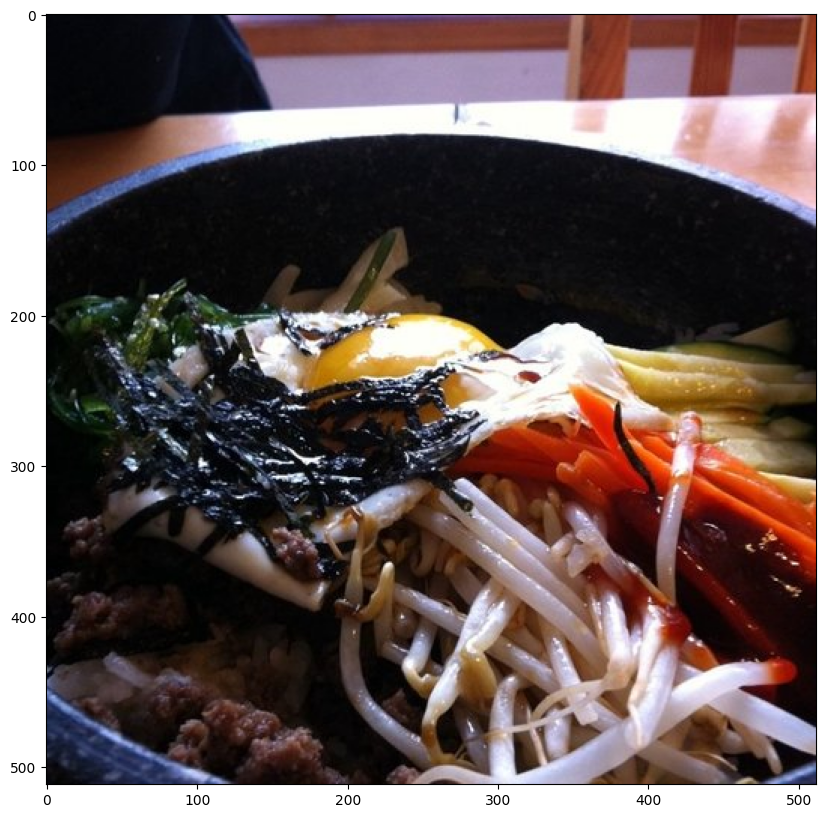

In [33]:
image = cv2.imread(train_split_images_path[0])
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
visualize(image)

(3, 512, 512)


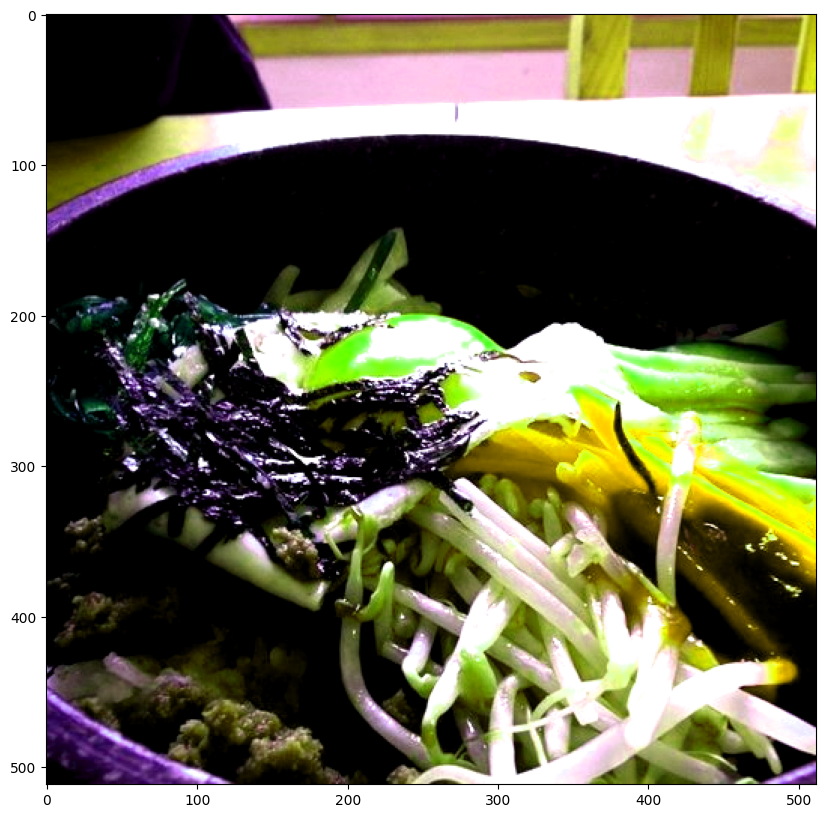

In [34]:
# transformation = transforms.ColorJitter(brightness=0.3, contrast = 0.5, saturation = 0.02, hue = 0.4)
transformation = transforms.ColorJitter(0.3, 0.5, 0.02, 0.4)
image = cv2.imread(train_split_images_path[0])
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
# print(image)
image_tf = torch.from_numpy(image).permute((2,0,1)) # converts a NumPy array into a PyTorch tensor, and then rearrange the dimensions of tensor
# print(image_tf)
image_tf = transformation(image_tf)
visualize(image_tf.numpy())

RANDOM SOLARIZE

(3, 512, 512)


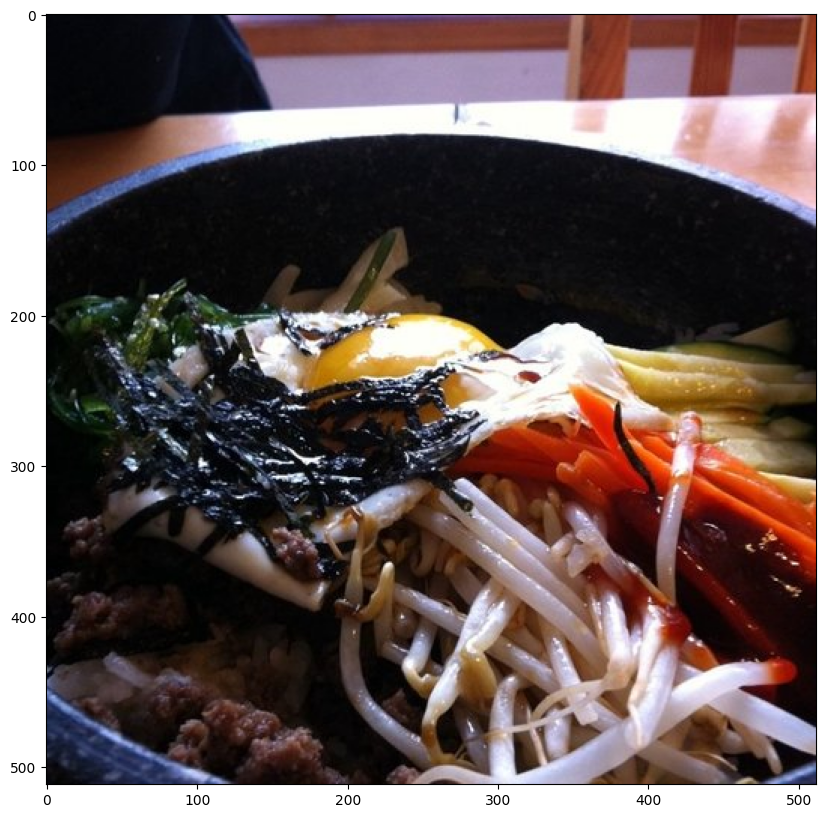

In [35]:
transformation = transforms.RandomSolarize(0.3) # change the relative
image = cv2.imread(train_split_images_path[0]) # open the first picture
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) # convert image to RGB because opencv read in BGR arrangements
image_tf = torch.from_numpy(image).permute((2,0,1)) # arrange to [3,H,W] dimension format
image_tf = transformation(image_tf)
visualize(image_tf.numpy())

RANDOM CROP

(3, 256, 256)


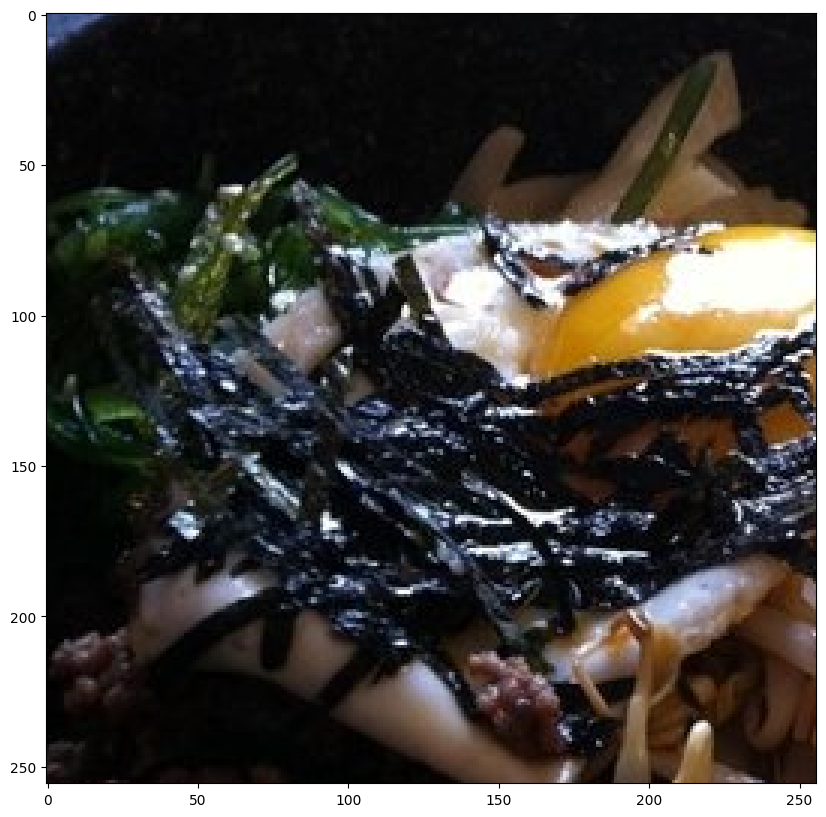

In [36]:
transformation = transforms.RandomCrop((256, 256))
image = cv2.imread(train_split_images_path[0]) # open the first picture
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) # convert image to RGB because opencv read in BGR arrangements
image_tf = torch.from_numpy(image).permute((2,0,1)) # arrange to [3,H,W] dimension format
image_tf = transformation(image_tf)
visualize(image_tf.numpy())

CHAINED AUGMENTATION

(3, 384, 384)


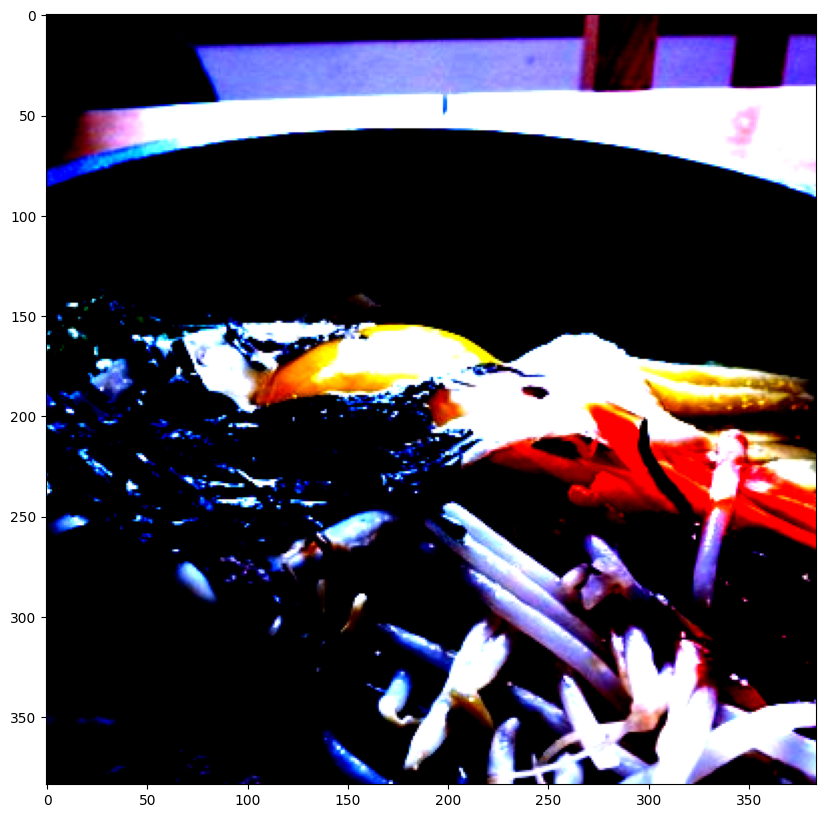

In [37]:
transformations = transforms.Compose([
    transforms.ToPILImage(),           # Convert a tensor or an ndarray to PIL Image
    transforms.RandomResizedCrop(384),
    transforms.RandomHorizontalFlip(), # Horizontally flip the given image randomly
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.51442681, 0.43435301, 0.33421855], std=[0.24099932, 0.246478, 0.23652802]) # Normalize a tensor image with mean and std. This transform does not support PIL image so it needed to change into tensor
])

image = cv2.imread(train_split_images_path[0])
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
image_pt = transformations(image)
visualize(image_pt.numpy())

(3, 384, 384)


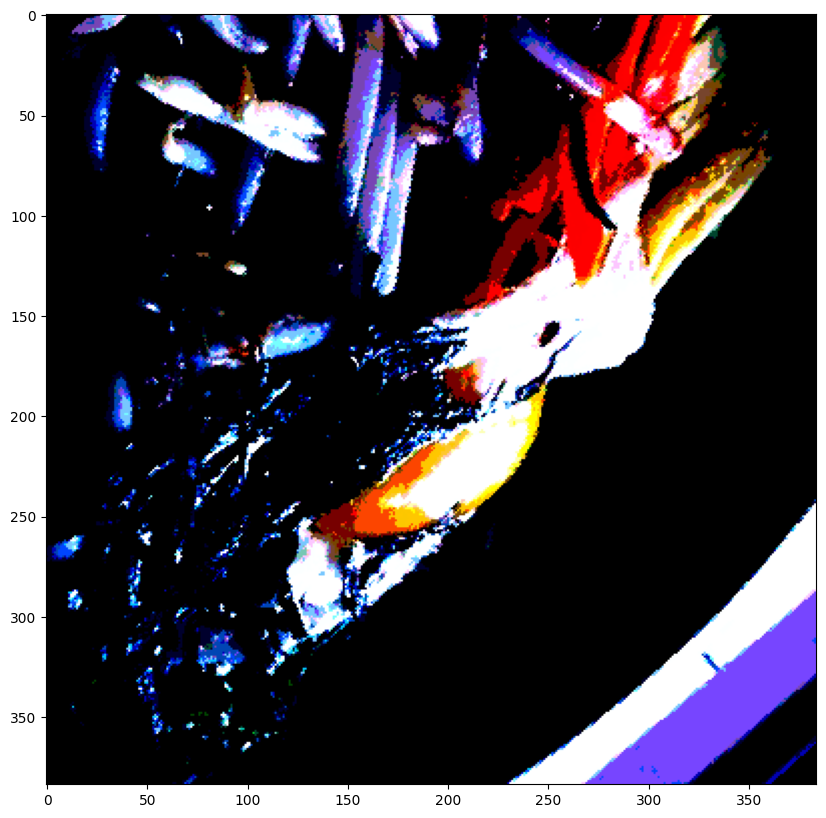

In [38]:
transformations = transforms.Compose([
    transforms.ToPILImage(),
    transforms.RandomRotation(60),
    transforms.RandomChoice([
        transforms.RandomHorizontalFlip(),
        transforms.RandomVerticalFlip(),
    ]),
    transforms.CenterCrop(384),
    transforms.RandomChoice([
        transforms.ColorJitter(0.3, 0.5, 0.02, 0.4),
        transforms.RandomPosterize(3),
    ]),
    transforms.RandomChoice([
        transforms.RandomEqualize(),
        transforms.RandomAutocontrast(),
    ]),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.51442681, 0.43435301, 0.33421855], std=[0.24099932, 0.246478, 0.23652802])
])

image = cv2.imread(train_split_images_path[0])
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
image_pt = transformations(image)
visualize(image_pt.numpy())

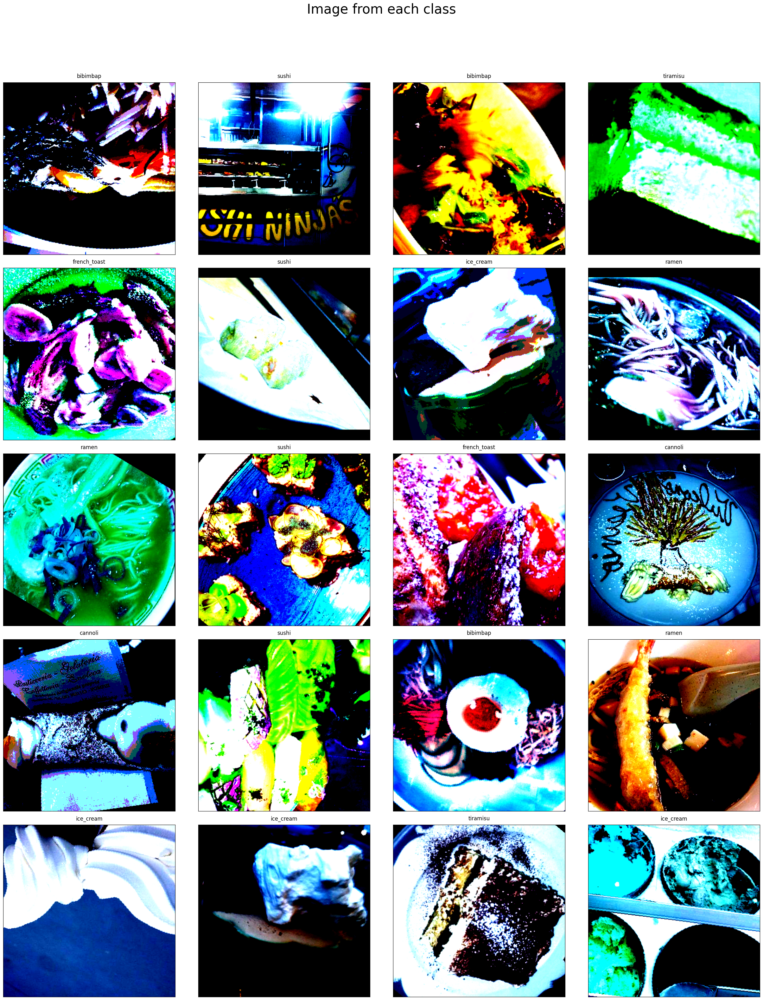

In [39]:
rows = 5
cols = 4
fig, axs = plt.subplots(rows, cols, figsize=(25,30))
axs = axs.ravel().tolist()

for idx, file_path in enumerate(train_split_images_path):
    image = cv2.imread(file_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image = transformations(image).numpy()
    image = np.transpose(image, (1,2,0))
    class_name = file_path.split('/')[-2]
    axs[idx].imshow(image)
    axs[idx].set_title(class_name, pad = 10)

fig.suptitle("Image from each class", y=1.05, fontsize=30)
plt.setp(axs, xticks=[],yticks=[])
plt.tight_layout()

Auto-Augmentation Policies

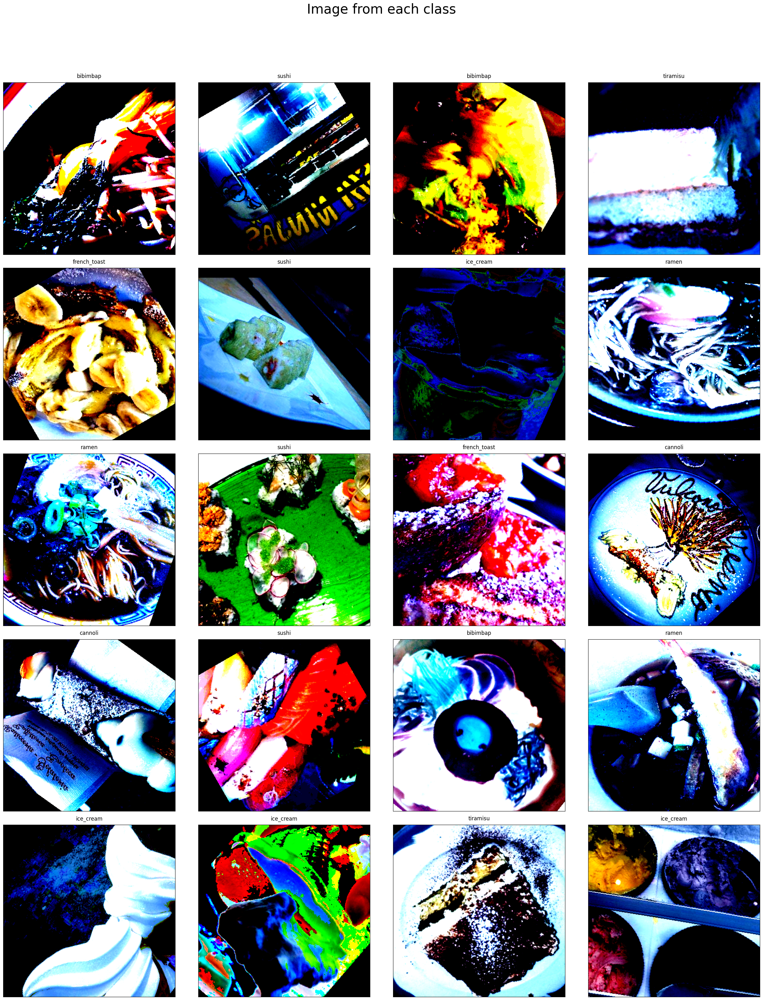

In [40]:
transformations = transforms.Compose([
    transforms.ToPILImage(),
    transforms.RandomRotation(60),
    transforms.RandomChoice([
        transforms.RandomHorizontalFlip(),
        transforms.RandomVerticalFlip(),
    ]),
    transforms.CenterCrop(384),
    transforms.AutoAugment(),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.51442681, 0.43435301, 0.33421855], std=[0.24099932, 0.246478, 0.23652802])
])

rows = 5
cols = 4
fig, axs = plt.subplots(rows, cols, figsize=(25,30))
axs = axs.ravel().tolist()

for idx, file_path in enumerate(train_split_images_path):
    image = cv2.imread(file_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image = transformations(image).numpy()
    image = np.transpose(image, (1, 2, 0))
    class_name = file_path.split('/')[-2]
    axs[idx].imshow(image)
    axs[idx].set_title(class_name, pad = 10)

fig.suptitle("Image from each class", y=1.05, fontsize=30)
plt.setp(axs, xticks=[],yticks=[])
plt.tight_layout()

(NOTE) Rotation - Translation - Flip
ROTATION + TRANSLATION

(3, 384, 384)


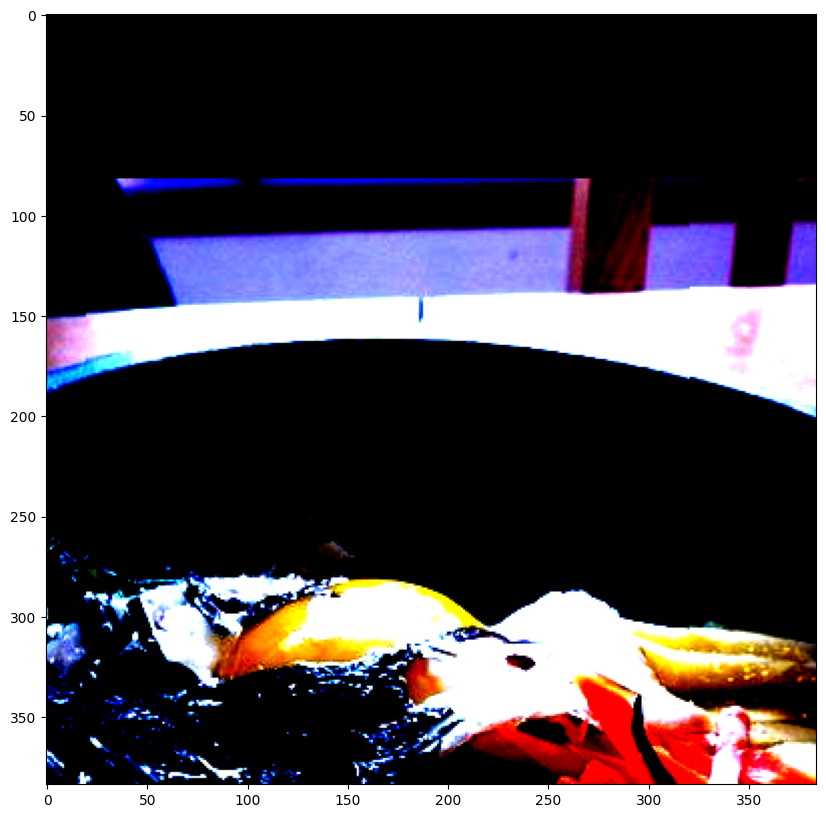

In [41]:
transformations = transforms.Compose([
    transforms.ToPILImage(),
    transforms.RandomRotation(60),
    transforms.RandomAffine(degrees=0, translate=(0.1, 0.5)),
    transforms.CenterCrop(384),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.51442681, 0.43435301, 0.33421855], std=[0.24099932, 0.246478, 0.23652802])
])

image = cv2.imread(train_split_images_path[0])
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
image_pt = transformations(image)
visualize(image_pt.numpy())

TRANSLATION + ROTATION

(3, 384, 384)


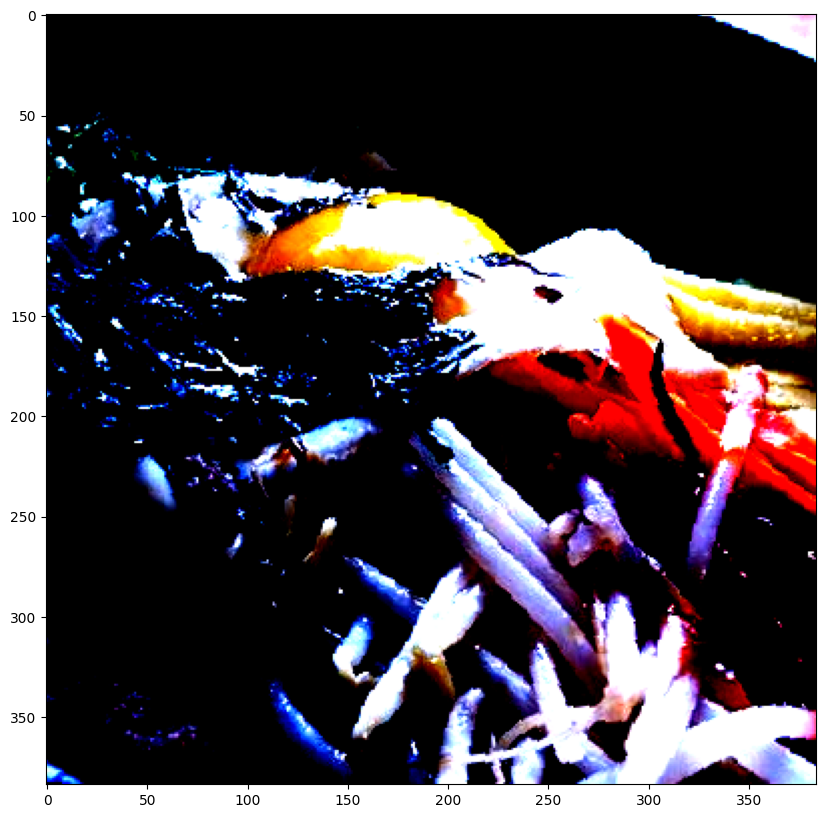

In [42]:
transformations = transforms.Compose([
    transforms.ToPILImage(),
    transforms.RandomAffine(degrees=0, translate=(0.1, 0.8)),
    transforms.RandomRotation(60),
    transforms.CenterCrop(384),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.51442681, 0.43435301, 0.33421855], std=[0.24099932, 0.246478, 0.23652802])
])

image = cv2.imread(train_split_images_path[0])
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
image_pt = transformations(image)
visualize(image_pt.numpy())

TRANSLATION + ROTATION + FLIPPING

(3, 384, 384)


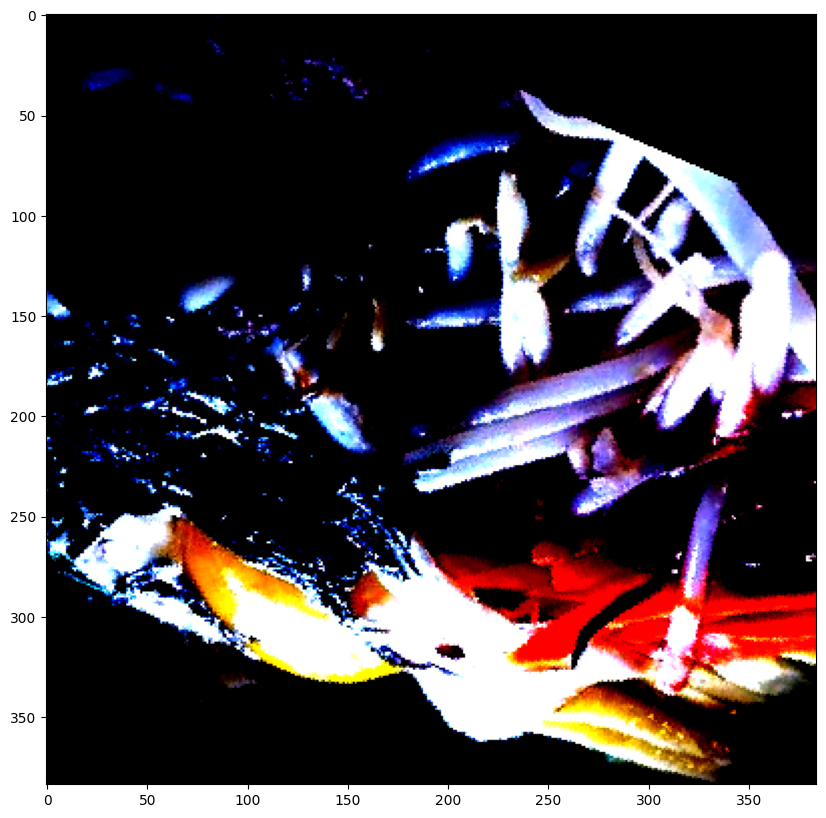

In [43]:
transformations = transforms.Compose([
    transforms.ToPILImage(),
    transforms.RandomAffine(degrees=0, translate=(0.1, 0.8)),
    transforms.RandomRotation(60),
        transforms.RandomChoice([
        transforms.RandomHorizontalFlip(),
        transforms.RandomVerticalFlip(),
    ]),
    transforms.CenterCrop(384),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.51442681, 0.43435301, 0.33421855], std=[0.24099932, 0.246478, 0.23652802])
])

image = cv2.imread(train_split_images_path[0])
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
image_pt = transformations(image)
visualize(image_pt.numpy())